In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

from sklearn.svm import SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor

#For inline plotting 
%matplotlib inline                 
%config InlineBackend.figure_format = 'svg'

plt.style.use("seaborn-v0_8-dark")  

In [4]:
# Make the dataset 

N = 1000 # number of observations 
X = np.random.random((N,2)) * 6 - 3 # 2D uniformly distributed data between (-3,3)

Y = np.cos(2*X[:,0]) + np.cos(3*X[:,1])

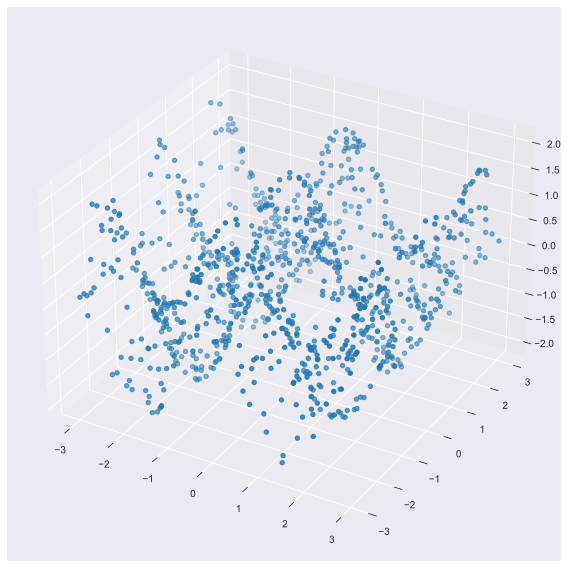

In [8]:
# Plot the actual sample 

fig = plt.figure(figsize = (15,10))

ax = fig.add_subplot(111,projection = '3d')

ax.scatter(X[:,0], X[:,1], Y);

### SVR (Support Vector Machine)
--------------

In [9]:
# SVR 

svr_model = SVR(C = 100.) # the C argument balances the amount of 'regularization'

svr_res = svr_model.fit(X,Y)


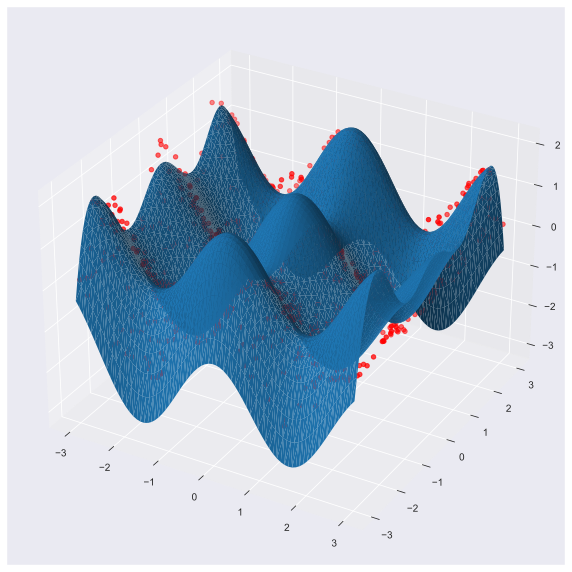

In [16]:
# Plot the simulated sample 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

ax.scatter(X[:,0], X[:,1],Y, color = 'red')

# surface plot 

line = np.linspace(-3,3,75)

xx, yy = np.meshgrid(line,line)

Xgrid = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat = svr_model.predict(Xgrid).flatten()

ax.plot_trisurf(Xgrid[:,0], Xgrid[:,1], Y_hat, linewidth = 0.1, antialiased = True)



Model does a good job for (new) data points withing the range of the original sample!

In [18]:
from sklearn.metrics import r2_score


r2_score(Y_hat,np.cos(2*Xgrid[:,0]) + np.cos(3*Xgrid[:,1]))

0.8589019286837918

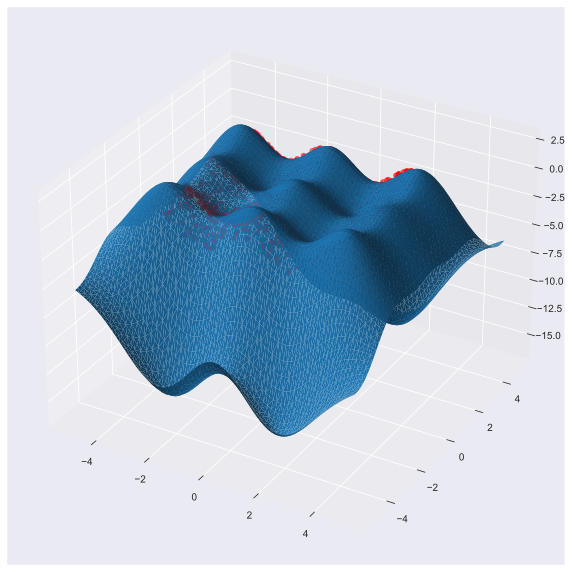

In [22]:
# Can it extrapolate? 
# Plot the simulated sample 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

ax.scatter(X[:,0], X[:,1],Y, color = 'red')

# surface plot 

line = np.linspace(-5,5,75)

xx, yy = np.meshgrid(line,line)

Xgrid2 = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat2 = svr_model.predict(Xgrid2).flatten()

ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], Y_hat2, linewidth = 0.1, antialiased = True)

In [23]:
# it is clear from the R^2 score that the model trained using the simulated feature data between -3,3 does not perform well when we extrapolate the 
# range of the grid 
r2_score(Y_hat2,np.cos(2*Xgrid2[:,0]) + np.cos(3*Xgrid2[:,1]))

-0.5648206742495392

In [25]:
# Visualize this statement by plotting the predictions vs the actual target surface 

# Can it extrapolate? 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

# surface plot of true vs predictions 

line = np.linspace(-5,5,75)

xx, yy = np.meshgrid(line,line)

Xgrid2 = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat2 = svr_model.predict(Xgrid2).flatten()

ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], Y_hat2, linewidth = 0.1, antialiased = True)
ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], np.cos(2*Xgrid2[:,0]) + np.cos(3*Xgrid2[:,1]), color = 'orange', alpha = 0.3, linewidth = 0.1, antialiased = True)

Notice that beyond (-3,3) in each axis, the model starts to perform really bad with respect to the actual values! 

### Random Forest Regressor
-----------

In [26]:
rf_model = RandomForestRegressor()

rf_model.fit(X,Y)

RandomForestRegressor()

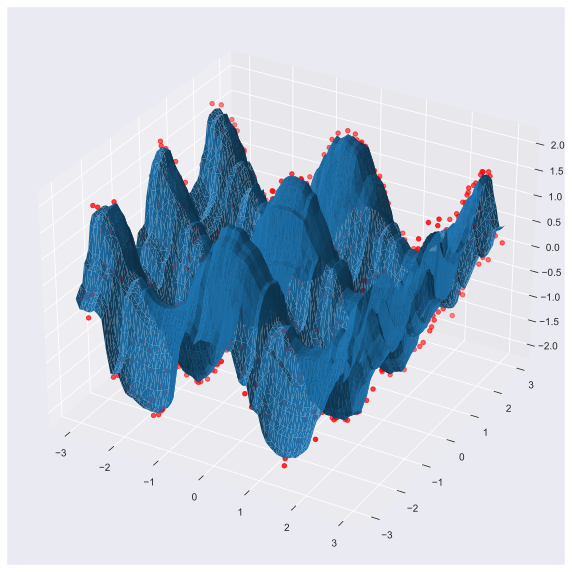

In [32]:
# Plot the simulated sample 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

ax.scatter(X[:,0], X[:,1],Y, color = 'red')

# surface plot 

line = np.linspace(-3,3,75)

xx, yy = np.meshgrid(line,line)

Xgrid = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat = rf_model.predict(Xgrid).flatten()

ax.plot_trisurf(Xgrid[:,0], Xgrid[:,1], Y_hat, linewidth = 0.1, antialiased = True)


The predictions are less granular due to the nature of the random forest regressor! Lets check $R^2$:

In [33]:
r2_score(Y_hat,np.cos(2*Xgrid[:,0]) + np.cos(3*Xgrid[:,1]))

0.94762750306421

In [28]:
# Can it extrapolate? 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

# surface plot of true vs predictions 

line = np.linspace(-5,5,75)

xx, yy = np.meshgrid(line,line)

Xgrid2 = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat2 = rf_model.predict(Xgrid2).flatten()

ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], Y_hat2, linewidth = 0.1, antialiased = True)
ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], np.cos(2*Xgrid2[:,0]) + np.cos(3*Xgrid2[:,1]), color = 'orange', alpha = 0.3, linewidth = 0.1, antialiased = True)

Notice that again the model can not perform well outside the range of its training input! Since RandomForest regressor is build out of bunch of decision trees, the predictions outside -3,3 are just horizontal lines!! Considering that each node in the decision trees are based on if, else statements this makes sense!!

### MLP (Multi Layer Perceptron: NN of sklearn)
------

In [29]:
mlp_model = MLPRegressor(hidden_layer_sizes=128, alpha = 0., learning_rate_init=0.01)

mlp_model.fit(X,Y)

MLPRegressor(alpha=0.0, hidden_layer_sizes=128, learning_rate_init=0.01)

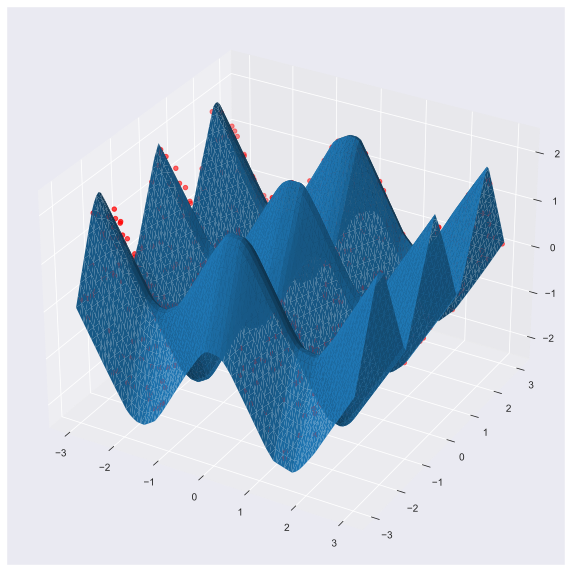

In [30]:
# Plot the simulated sample 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

ax.scatter(X[:,0], X[:,1],Y, color = 'red')

# surface plot 

line = np.linspace(-3,3,75)

xx, yy = np.meshgrid(line,line)

Xgrid = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat = mlp_model.predict(Xgrid).flatten()

ax.plot_trisurf(Xgrid[:,0], Xgrid[:,1], Y_hat, linewidth = 0.1, antialiased = True)

In [31]:
# notice that it does perform much better than svr and random forest 
r2_score(Y_hat,np.cos(2*Xgrid[:,0]) + np.cos(3*Xgrid[:,1]))

0.9870892731777499

In [34]:
# Can it extrapolate? 

fig = plt.figure(figsize = (10,15))

ax = fig.add_subplot(111, projection = '3d')

# surface plot of true vs predictions 

line = np.linspace(-5,5,75)

xx, yy = np.meshgrid(line,line)

Xgrid2 = np.vstack((xx.flatten(),yy.flatten())).T

Y_hat2 = mlp_model.predict(Xgrid2).flatten()

ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], Y_hat2, linewidth = 0.1, antialiased = True)
ax.plot_trisurf(Xgrid2[:,0], Xgrid2[:,1], np.cos(2*Xgrid2[:,0]) + np.cos(3*Xgrid2[:,1]), color = 'orange', alpha = 0.3, linewidth = 0.1, antialiased = True)

Extends the predictions in a linear fashion which makes sense for linear activation functions of NN's! 

We can conclude that ML models can not extrapolate!!!

Lets illustrate explicitly, how does this concept of extrapolation is related to time series forecasting!! 
 

### Stock Prices
-----------

In [35]:
!wget -nc https://lazyprogrammer.me/course_files/SPY.csv

--2024-04-15 22:45:45--  https://lazyprogrammer.me/course_files/SPY.csv
Resolving lazyprogrammer.me (lazyprogrammer.me)... 104.21.23.210, 172.67.213.166
Connecting to lazyprogrammer.me (lazyprogrammer.me)|104.21.23.210|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 251935 (246K) [text/csv]
Saving to: 'SPY.csv'

SPY.csv             100%[===================>] 246.03K  1.45MB/s    in 0.2s    

2024-04-15 22:45:46 (1.45 MB/s) - 'SPY.csv' saved [251935/251935]



In [2]:
import pandas as pd 

df = pd.read_csv('SPY.csv', index_col= 0, parse_dates = True)

df.head()


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,112.370003,113.389999,111.510002,113.330002,92.246048,118944600
2010-01-05,113.260002,113.680000,112.849998,113.629997,92.490204,111579900
2010-01-06,113.519997,113.989998,113.430000,113.709999,92.555328,116074400
2010-01-07,113.500000,114.330002,113.180000,114.190002,92.946060,131091100
2010-01-08,113.889999,114.620003,113.660004,114.570000,93.255348,126402800


In [5]:
# train-test split 

train, test = df.iloc[:2000]['Close'].to_numpy(), df.iloc[2000:]['Close'].to_numpy()

train.shape, test.shape

((2000,), (263,))

In [6]:
# produce pretend input data from the close prices where we will pretend to predict prices with two lags 
# y(t) = f(y(t-1),y(t-2))

X_train = []
for t in range(len(train)-1):

    x0 = train[t]
    x1 = train[t+1]
    X_train.append((x0,x1))

X_test = []
for t in range(len(test)-1):

    x0 = test[t]
    x1 = test[t+1]
    X_test.append((x0,x1))

X_train = np.array(X_train)
X_test = np.array(X_test)

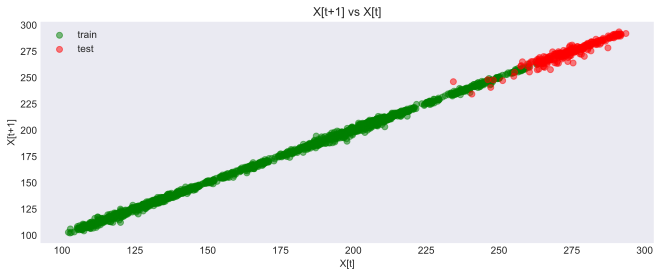

In [7]:
# scatter plot of X[t] vs X[t+1]

fig, axes = plt.subplots(figsize = (11,4))

axes.set_xlabel('X[t]')
axes.set_ylabel('X[t+1]')
axes.set_title('X[t+1] vs X[t]')

axes.scatter(X_train[:,0],X_train[:,1], c= 'g', alpha = 0.5, label = 'train')
axes.scatter(X_test[:,0],X_test[:,1], c = 'r', alpha = 0.5, label = 'test')

axes.legend()


Train inputs occupy a totaly different region of the whole input space as compared to the test set. So if we use stock prices as inputs into a machine learning model, the test data would require extrapolation, the model only gets to train green range of values!